## Importando as bibliotecas e fazendo conexão com o Drive

In [ ]:
# Bibliotecas
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import torchvision.transforms as T
import os
import pandas as pd
from collections import deque

from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Importando nosso modelo de detecção e montando a lógica de tracking

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-27-c3d004cae040>:31: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(model_path, map_location=device)


Modelo carregado com sucesso!
Total de frames no vídeo: 81992


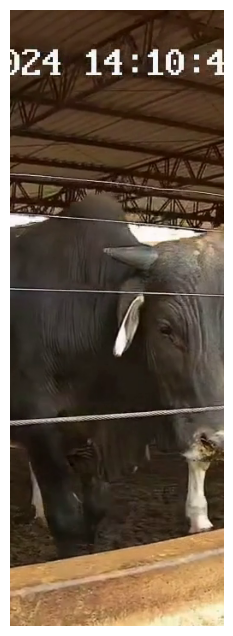

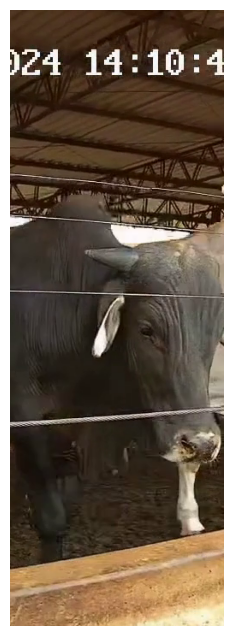

Frame 1502: Novo bovino detectado com ID 1


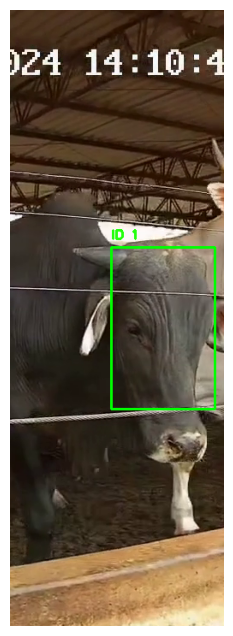

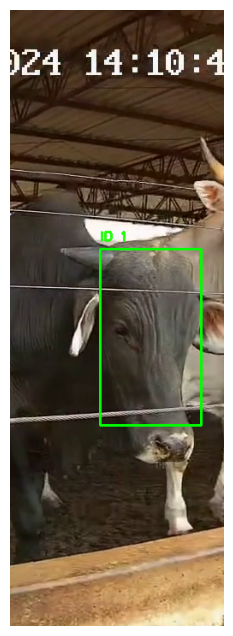

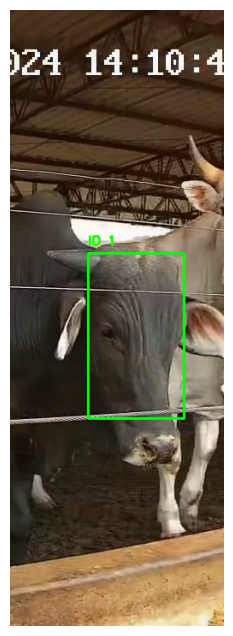

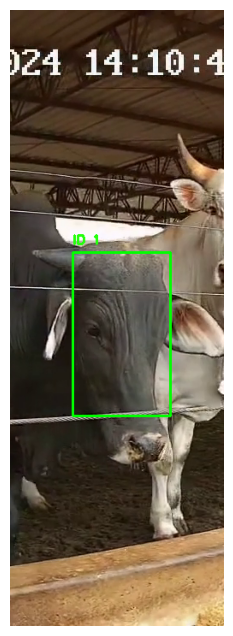

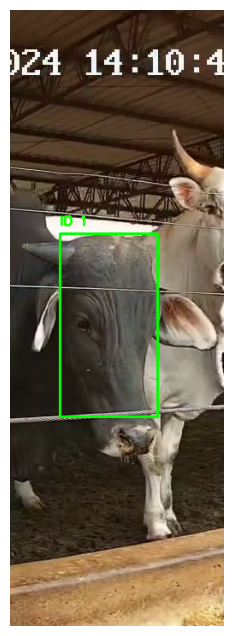

...

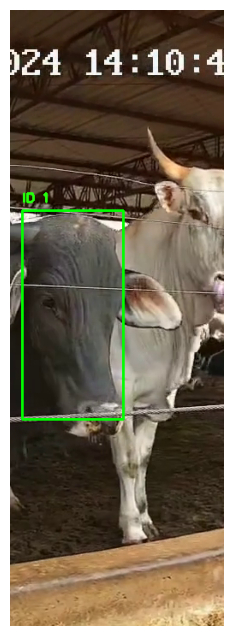

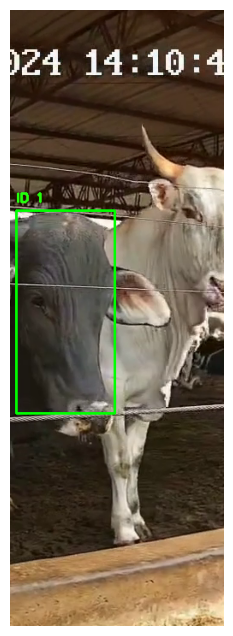

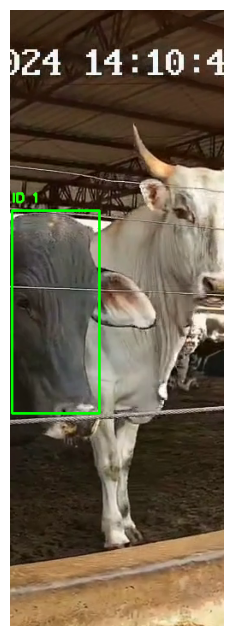

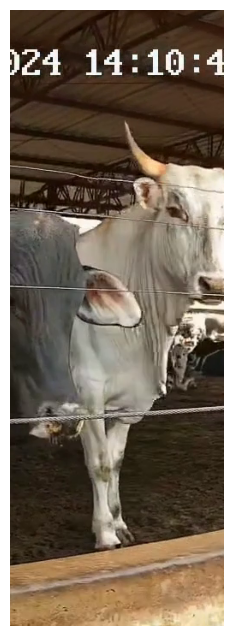

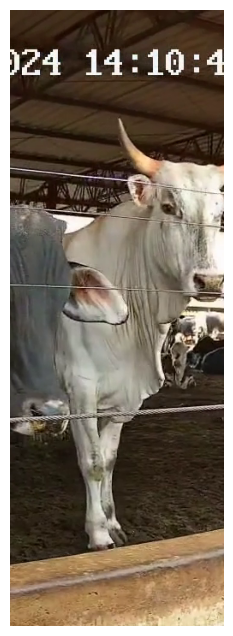

Frame 1514: Novo bovino detectado com ID 2


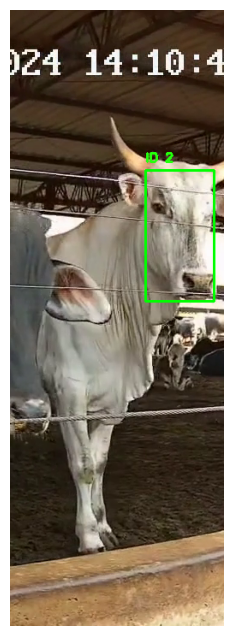

Frame 1515: ID 1 removido por exceder idade máxima


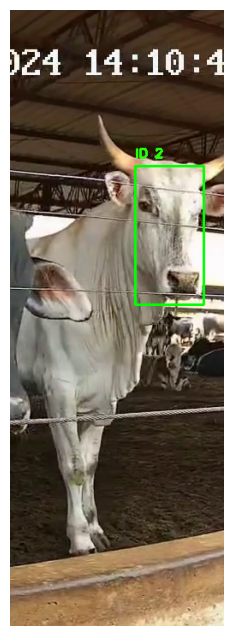

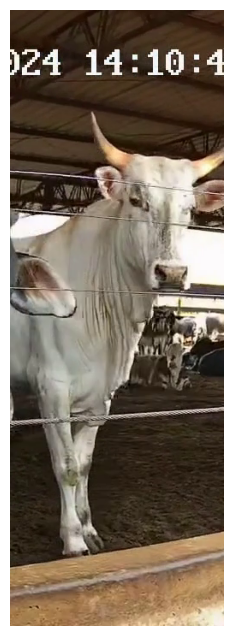

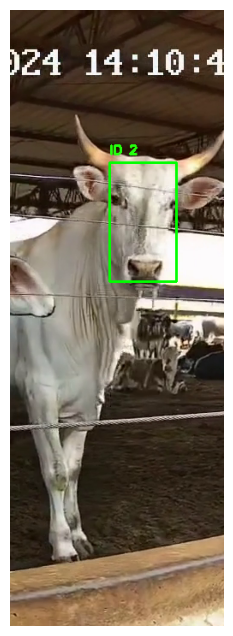

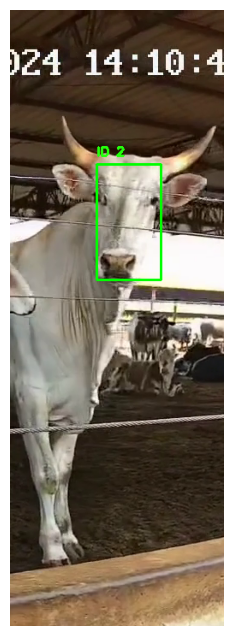

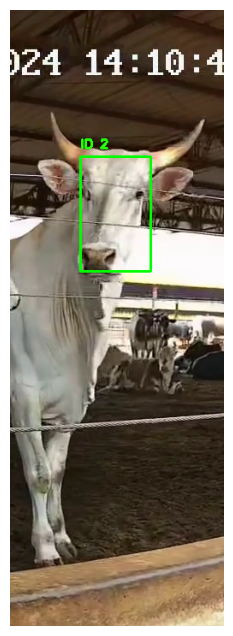

...

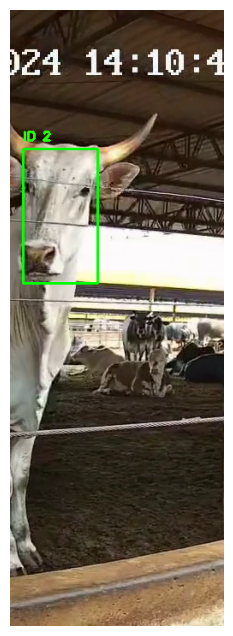

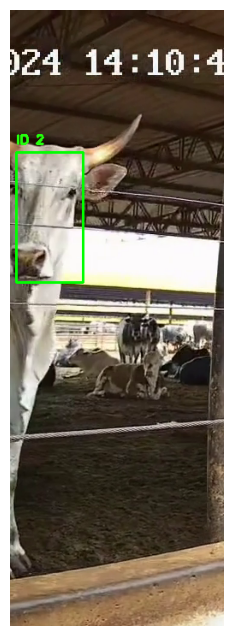

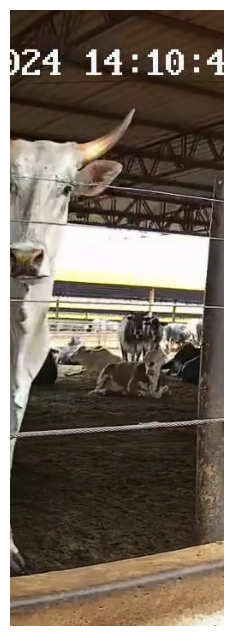

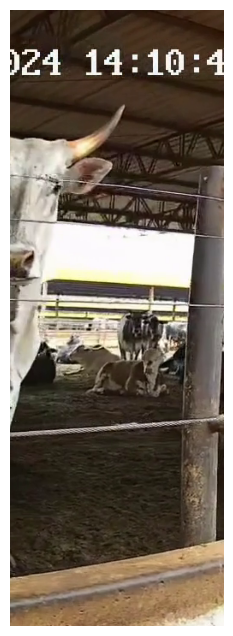

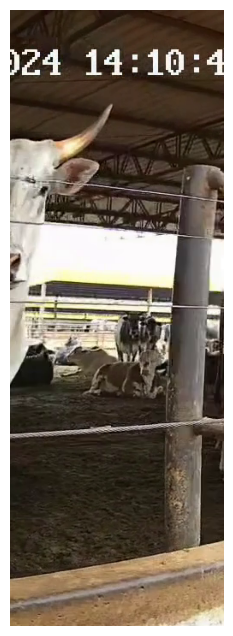

Frame 1528: ID 2 removido por exceder idade máxima


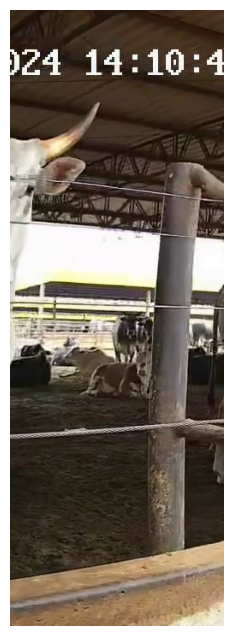

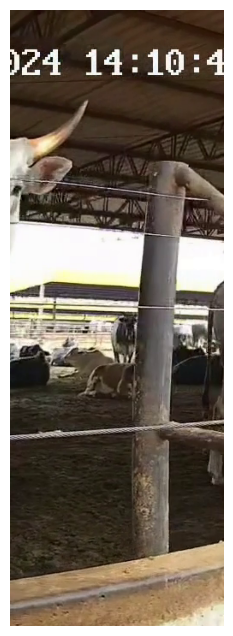

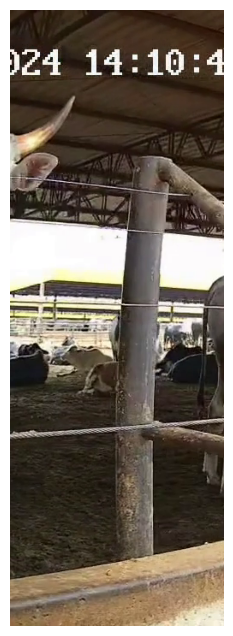

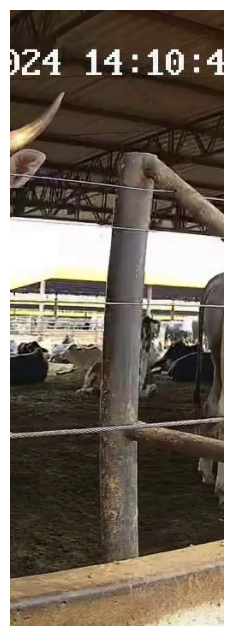

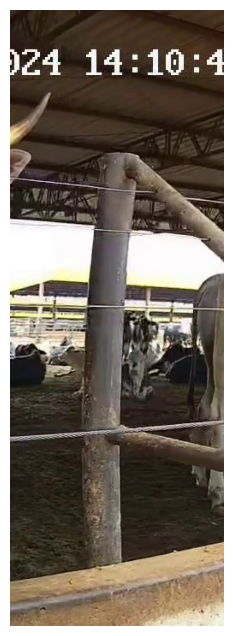

...

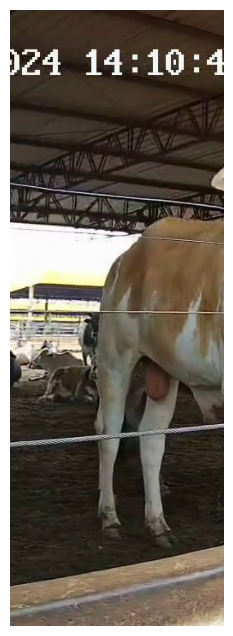

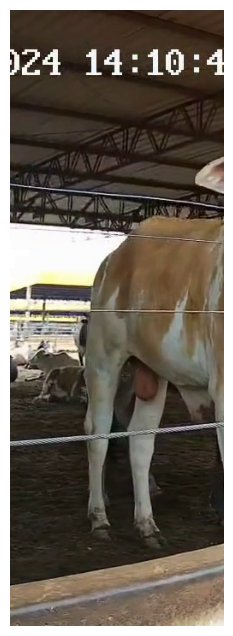

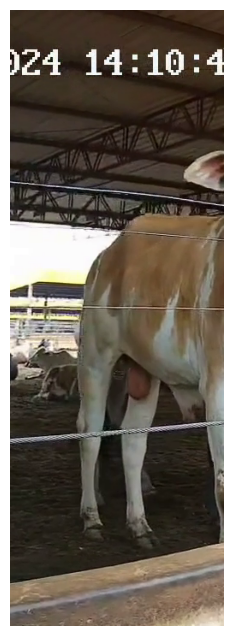

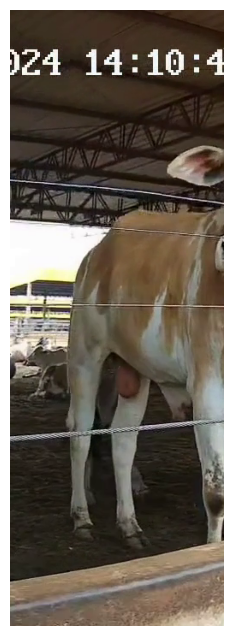

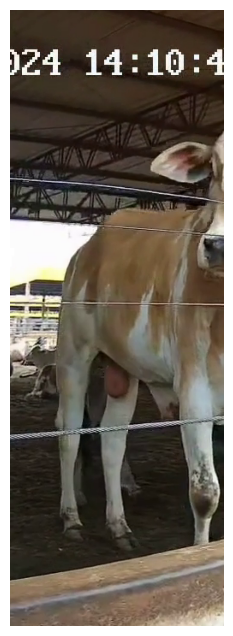

Frame 1552: Novo bovino detectado com ID 3


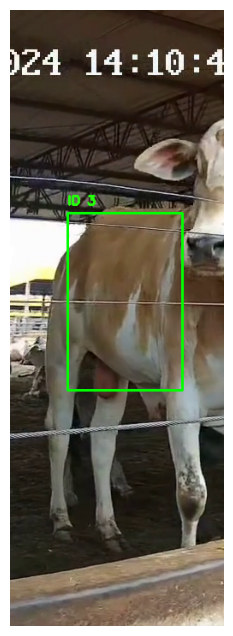

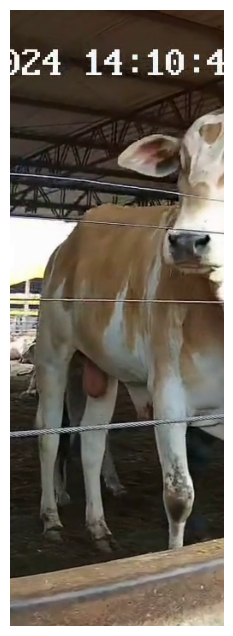

Frame 1554: Novo bovino detectado com ID 4


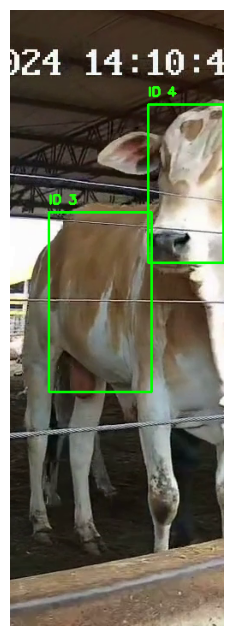

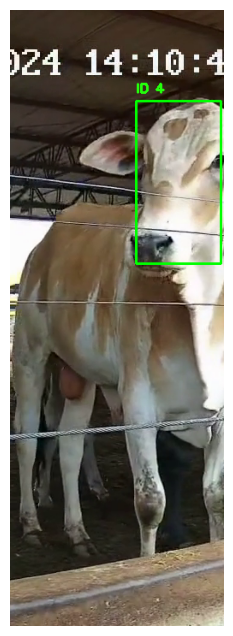

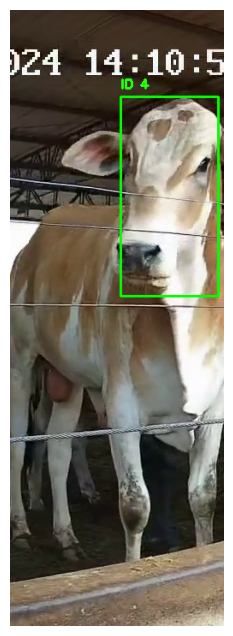

Frame 1557: ID 3 removido por exceder idade máxima


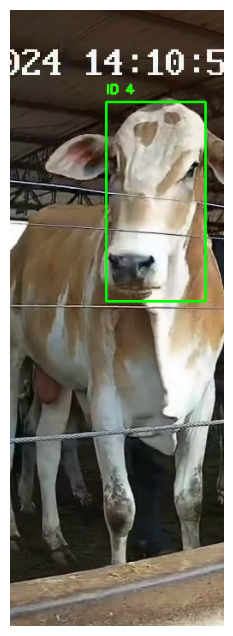

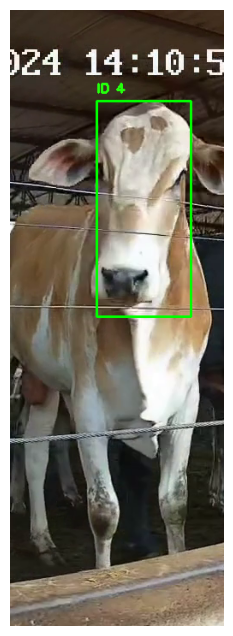

Frame 1559: Novo bovino detectado com ID 5


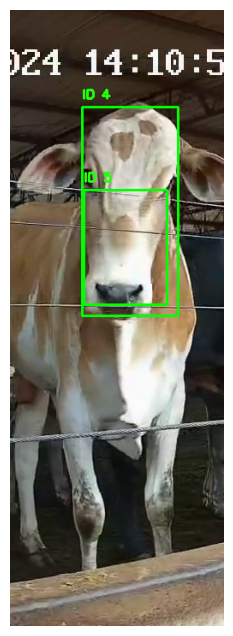

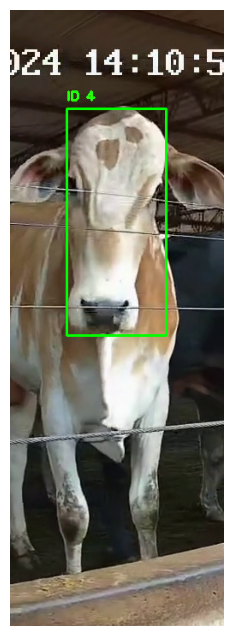

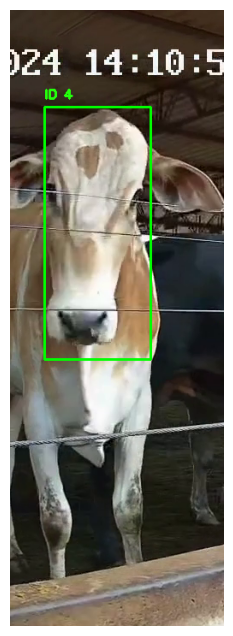

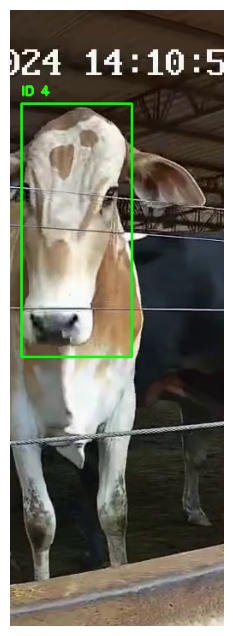

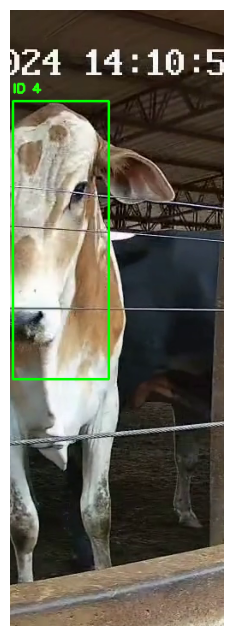

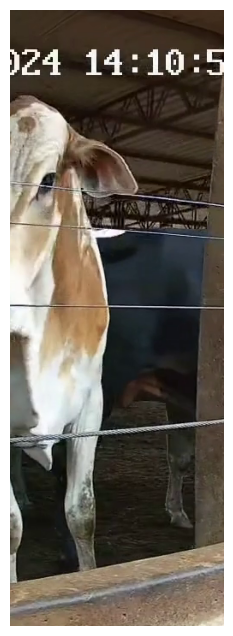

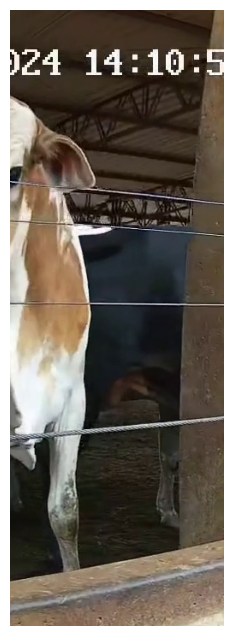

Frame 1566: ID 5 removido por exceder idade máxima


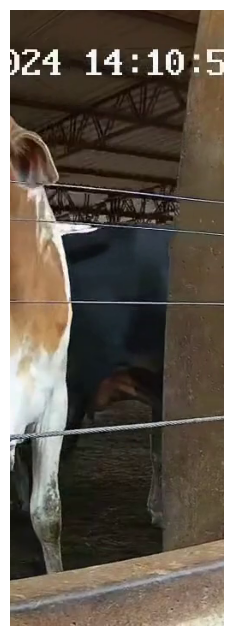

Frame 1567: ID 4 removido por exceder idade máxima


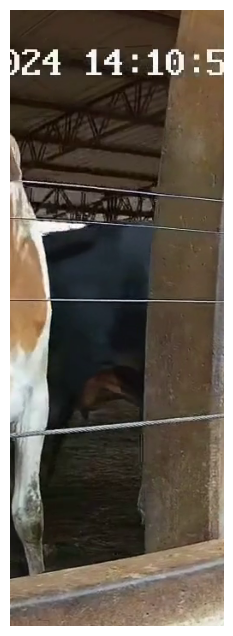

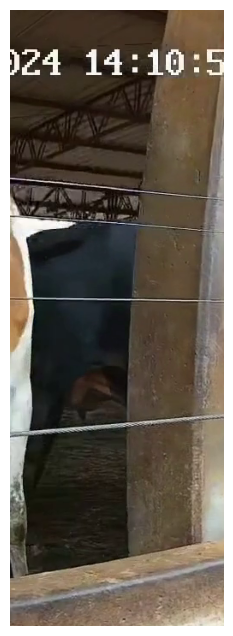

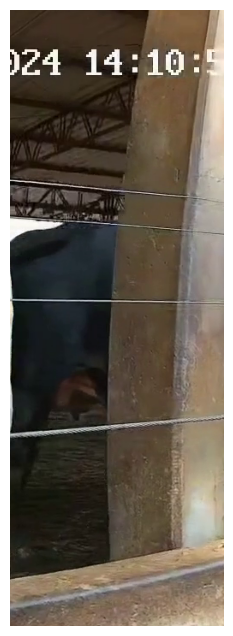

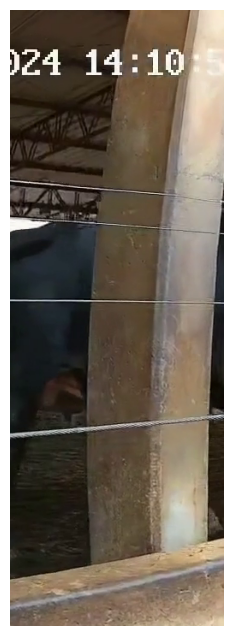

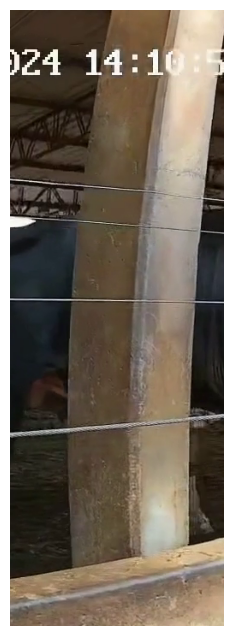

...

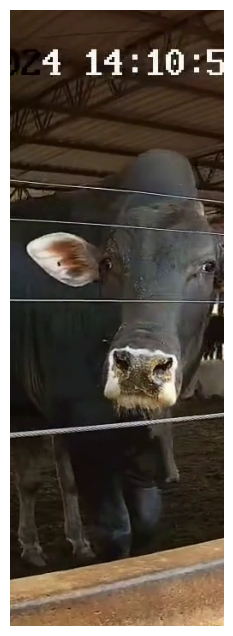

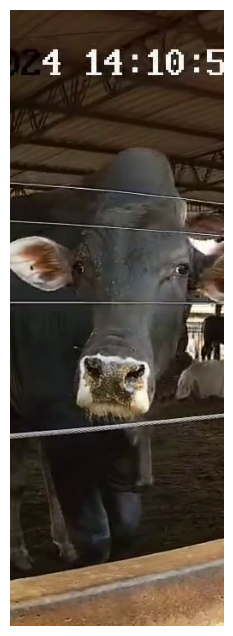

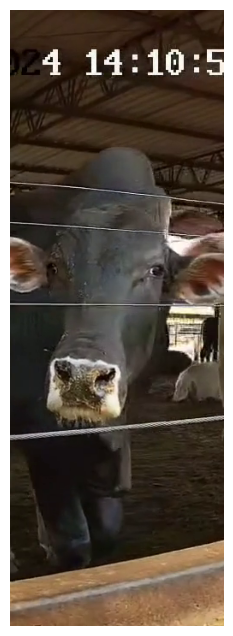

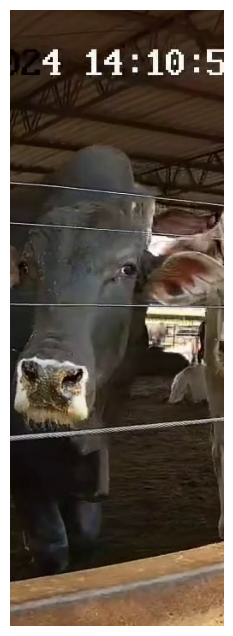

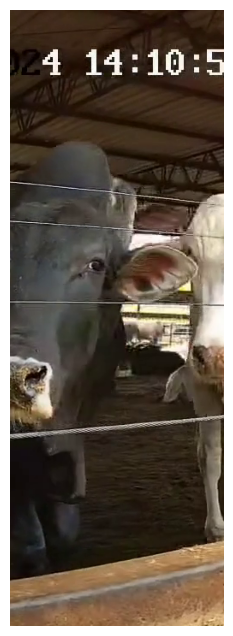

Frame 1586: Novo bovino detectado com ID 6


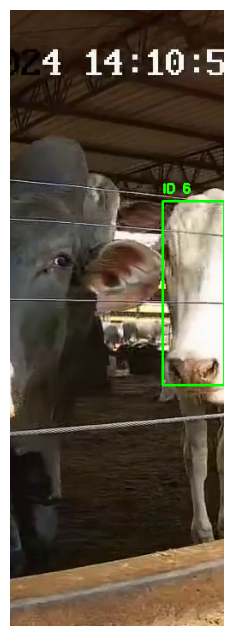

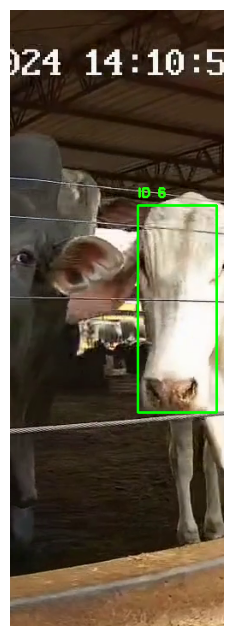

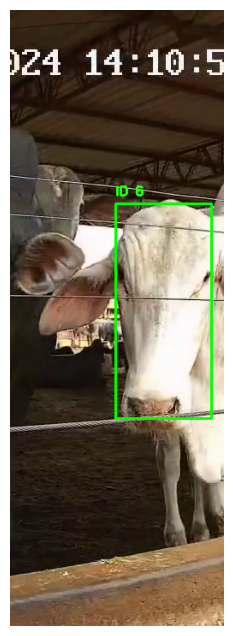

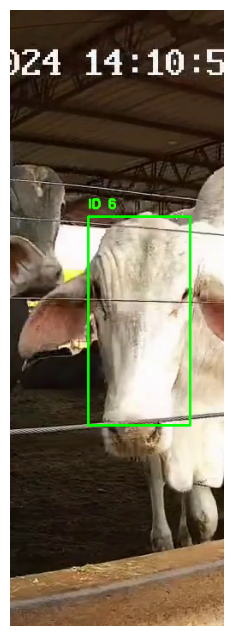

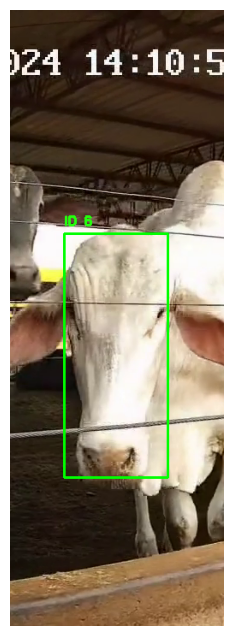

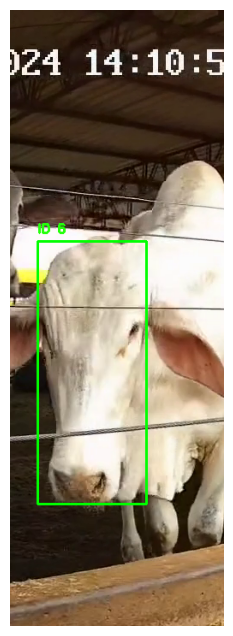

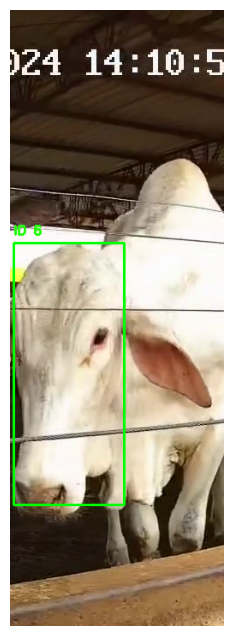

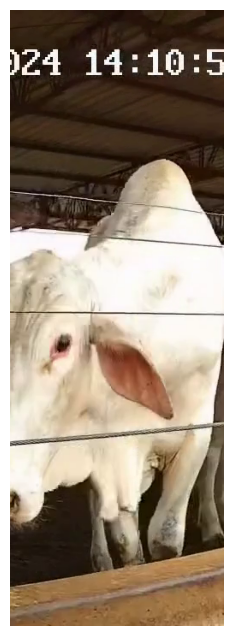

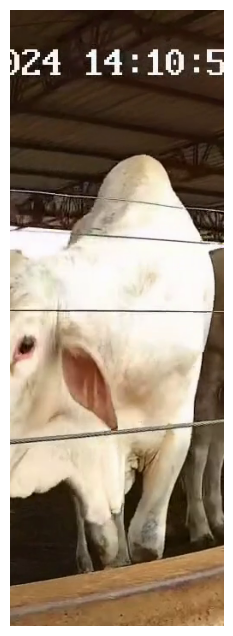

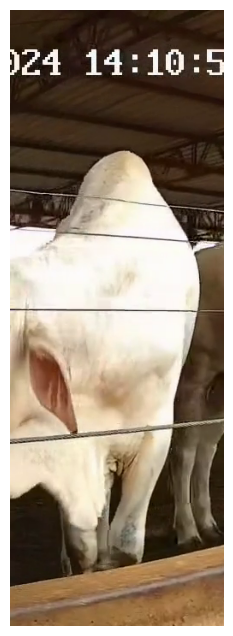

Frame 1596: ID 6 removido por exceder idade máxima


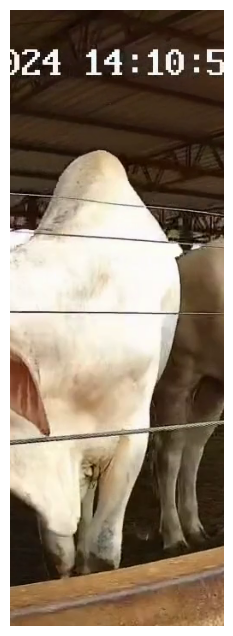

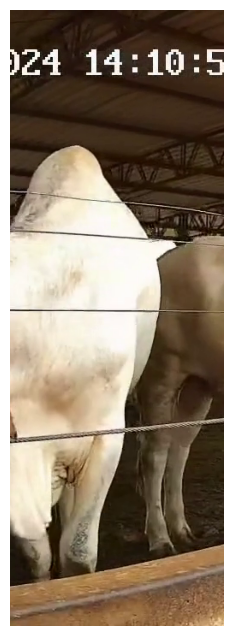

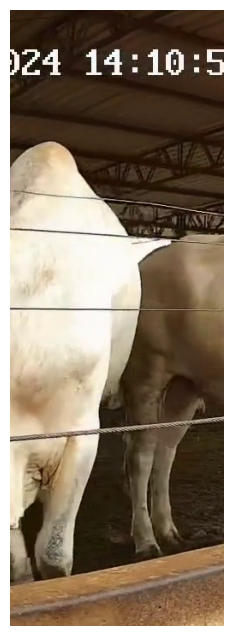

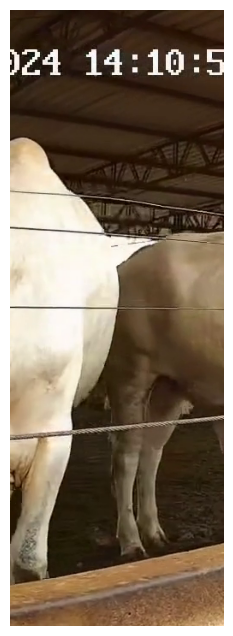

Dados de tracking salvos em /content/drive/MyDrive/approach_nwot/tracking_data.xlsx
Total de bovinos únicos detectados: 6


In [ ]:
# Definir dispositivo
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# Função para carregar o modelo completo
def load_complete_model(model_path):
    """
    Carrega um modelo completo salvo com torch.save(model, PATH).

    Args:
        model_path (str): Caminho para o arquivo .pth do modelo.

    Returns:
        torch.nn.Module: Modelo carregado.
    """
    model = torch.load(model_path, map_location=device)
    model.to(device)
    model.eval()
    return model

# Função para calcular IoU entre duas caixas delimitadoras
def compute_iou(box1, box2):
    """
    Calcula a Interseção sobre a União (IoU) entre duas caixas delimitadoras.

    Args:
        box1 (list ou array): [x1, y1, x2, y2]
        box2 (list ou array): [x1, y1, x2, y2]

    Returns:
        float: Valor da IoU.
    """
    x_left = max(box1[0], box2[0])
    y_top = max(box1[1], box2[1])
    x_right = min(box1[2], box2[2])
    y_bottom = min(box1[3], box2[3])

    if x_right < x_left or y_bottom < y_top:
        return 0.0

    intersection_area = (x_right - x_left) * (y_bottom - y_top)
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])

    iou = intersection_area / float(box1_area + box2_area - intersection_area)
    return iou

# Função para calcular a distância entre centróides
def compute_centroid_distance(box1, box2):
    """
    Calcula a distância Euclidiana entre os centróides de duas caixas delimitadoras.

    Args:
        box1 (list ou array): [x1, y1, x2, y2]
        box2 (list ou array): [x1, y1, x2, y2]

    Returns:
        float: Distância Euclidiana.
    """
    centroid1 = [(box1[0] + box1[2]) / 2, (box1[1] + box1[3]) / 2]
    centroid2 = [(box2[0] + box2[2]) / 2, (box2[1] + box2[3]) / 2]
    distance = np.sqrt((centroid1[0] - centroid2[0])**2 + (centroid1[1] - centroid2[1])**2)
    return distance

# Caminhos para o modelo e vídeo
model_path = '/content/drive/MyDrive/approach_nwot/models/modelo_deteccao_cabeca_completo.pth'
video_file = '/content/drive/MyDrive/approach_nwot/videos/video_colorido_concatenado_10fps.mp4'

# Definir intervalos de recorte
color_crop_rows = (0, 720)
color_crop_cols = (250, 500)

# Carregar o modelo completo
model = load_complete_model(model_path)

# Verificar se o modelo foi carregado corretamente
print("Modelo carregado com sucesso!")

# Inicializar captura de vídeo
cap = cv2.VideoCapture(video_file)
frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print(f"Total de frames no vídeo: {frame_count}")

# Inicializar variáveis para tracking
cow_id_counter = 0       # Contador para IDs únicos
cow_ids = {}             # Mapeamento de IDs para bounding boxes
tracking_data = []       # Lista para armazenar dados de tracking
iou_threshold = 0.3      # Ajustado para tornar o tracking menos sensível
distance_threshold = 50  # Limite de distância para correspondência (em pixels)
conf_threshold = 0.5     # Limite de confiança para detecções
start_frame = 1500         # Frame inicial para análise
end_frame = 1600           # Frame final para análise (ajuste conforme necessário)
max_display_frames = 100  # Número de frames a serem exibidos

# Histórico de bounding boxes para cada ID (últimos N frames)
history_length = 5
cow_history = {}  # Dicionário: ID -> deque de bounding boxes

# Tempo de vida máximo para IDs inativos
max_age = 3  # Número de frames sem correspondência antes de remover o ID
cow_age = {}  # Dicionário: ID -> número de frames sem correspondência

# Loop de processamento de frames
for frame_num in range(start_frame, end_frame):
    # Posicionar no frame desejado
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_num)
    ret, frame = cap.read()
    if not ret:
        print(f"Frame {frame_num} não pôde ser lido. Finalizando.")
        break

    # Recortar o frame
    cropped_frame = frame[color_crop_rows[0]:color_crop_rows[1], color_crop_cols[0]:color_crop_cols[1]]

    # Converter para RGB e tensor
    img_rgb = cv2.cvtColor(cropped_frame, cv2.COLOR_BGR2RGB)
    img_tensor = T.ToTensor()(img_rgb).to(device)

    # Realizar detecção
    with torch.no_grad():
        detections = model([img_tensor])

    # Extrair caixas, scores e labels
    boxes = detections[0]['boxes'].cpu().numpy()
    scores = detections[0]['scores'].cpu().numpy()
    labels = detections[0]['labels'].cpu().numpy()

    # Filtrar detecções por confiança
    indices = np.where(scores > conf_threshold)[0]
    boxes = boxes[indices]
    scores = scores[indices]
    labels = labels[indices]

    current_heads = []  # Cabeças detectadas no frame atual
    current_ids = []     # IDs atribuídos às cabeças detectadas

    # Lista para acompanhar quais IDs já foram correspondidos neste frame
    matched_ids = set()

    # Para cada detecção atual, tentar encontrar correspondência com IDs existentes
    for box in boxes:
        best_iou = 0
        best_id = None
        best_distance = float('inf')

        for cid, history in cow_history.items():
            # Considerar apenas os últimos N frames para correspondência
            for prev_box in list(history)[-history_length:]:
                iou = compute_iou(box, prev_box)
                distance = compute_centroid_distance(box, prev_box)
                if iou > best_iou and distance < best_distance:
                    best_iou = iou
                    best_id = cid
                    best_distance = distance

        # Definir critérios de correspondência
        if best_iou > iou_threshold and best_distance < distance_threshold and best_id not in matched_ids:
            # Correspondência encontrada
            current_heads.append(box)
            current_ids.append(best_id)
            matched_ids.add(best_id)
            # Atualizar histórico
            cow_history[best_id].append(box)
            # Resetar contador de idade
            cow_age[cid] = 0
        else:
            # Nova cabeça detectada
            cow_id_counter += 1
            current_heads.append(box)
            current_ids.append(cow_id_counter)
            matched_ids.add(cow_id_counter)
            # Inicializar histórico para o novo ID
            cow_history[cow_id_counter] = deque(maxlen=history_length)
            cow_history[cow_id_counter].append(box)
            # Inicializar idade
            cow_age[cow_id_counter] = 0
            print(f"Frame {frame_num}: Novo bovino detectado com ID {cow_id_counter}")

    # Incrementar a idade de todos os IDs que não foram correspondidos neste frame
    for cid in list(cow_age.keys()):
        if cid not in matched_ids:
            cow_age[cid] += 1
            if cow_age[cid] > max_age:
                # Remover ID se exceder o máximo de idade
                if cid in cow_ids:
                    del cow_ids[cid]
                if cid in cow_history:
                    del cow_history[cid]
                if cid in cow_age:
                    del cow_age[cid]
                print(f"Frame {frame_num}: ID {cid} removido por exceder idade máxima")

    # Atualizar cow_ids com os IDs atuais
    cow_ids = {cid: box for cid, box in zip(current_ids, current_heads)}

    # Registrar dados de tracking
    for box, cid in zip(current_heads, current_ids):
        tracking_data.append({
            'frame': frame_num,
            'id': cid,
            'x1': int(box[0]),
            'y1': int(box[1]),
            'x2': int(box[2]),
            'y2': int(box[3])
        })

    # Visualizar as detecções com IDs
    img_display = img_rgb.copy()
    for box, cid in zip(current_heads, current_ids):
        x1, y1, x2, y2 = box.astype(int)
        cv2.rectangle(img_display, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(img_display, f"ID {cid}", (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (36, 255, 12), 2)

    # Converter de volta para BGR para plotagem com Matplotlib
    img_display = cv2.cvtColor(img_display, cv2.COLOR_RGB2BGR)
    img_display = np.ascontiguousarray(img_display, dtype=np.uint8)

    # Plotar o frame
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(img_display, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    # Incrementar contador de frames exibidos
    if (frame_num - start_frame + 1) >= max_display_frames:
        break

# Liberar a captura de vídeo
cap.release()

# Converter os dados de tracking para DataFrame e exportar para Excel
df_tracking = pd.DataFrame(tracking_data)
excel_file = '/content/drive/MyDrive/approach_nwot/tracking_data.xlsx'
df_tracking.to_excel(excel_file, index=False)
print(f"Dados de tracking salvos em {excel_file}")

# Contar o número total de bovinos únicos
total_unique_cows = df_tracking['id'].nunique()
print(f"Total de bovinos únicos detectados: {total_unique_cows}")
